In [1]:
%tensorflow_version 2.x
import tensorflow as tf
print("TF Version: ", tf.__version__)
device_name = tf.test.gpu_device_name()
IS_GPU = tf.test.gpu_device_name() == '/device:GPU:0'
if not IS_GPU:
  # raise SystemError('GPU device not found')
  pass
import numpy as np
np.set_printoptions(precision=3)

import os
import random
import time
import PIL.Image as Image
import matplotlib.pyplot as plt
%matplotlib inline

!git clone https://github.com/mixuala/tf_utils.git
from tf_utils import helpers
from tf_utils.io import load, show, save

!git clone https://github.com/mixuala/fast_neural_style_pytorch.git
from fast_neural_style_pytorch import transformer, vgg, utils
import fast_neural_style_pytorch.utils as torch_utils

from fast_neural_style_pytorch.tensorflow import utils as fnstf_utils
from fast_neural_style_pytorch.tensorflow import vgg as tf_vgg
from fast_neural_style_pytorch.tensorflow import transformer as tf_transformer

!git clone https://github.com/mixuala/colab_utils.git
import colab_utils.tboard

TensorFlow 2.x selected.
TF Version:  2.1.0
fatal: destination path 'tf_utils' already exists and is not an empty directory.
fatal: destination path 'fast_neural_style_pytorch' already exists and is not an empty directory.
fatal: destination path 'colab_utils' already exists and is not an empty directory.


# settings

In [0]:
# GLOBAL SETTINGS
DATASET_PATH = "/content/train"
RECORD_PATH = '/content/coco2014-sq-1000.tfrecord'
LOG_PATH = "/content/logs/"
STYLE_IMAGE_PATH = "/content/mosaic.jpg"
SAVE_MODEL_PATH = "/content/checkpoint/"
SAVE_IMAGE_PATH = SAVE_MODEL_PATH

TRAIN_IMAGE_SIZE = 256
NUM_EPOCHS = 5
NUM_BATCHES = 250
BATCH_SIZE = 4 
# CONTENT_WEIGHT = 1 
# STYLE_WEIGHT = 1
TV_WEIGHT = 1e-6 
ADAM_LR = 0.001
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 36
PLOT_LOSS = 1


# download data

In [0]:
if not os.path.isfile(STYLE_IMAGE_PATH):
  !wget -O $STYLE_IMAGE_PATH https://raw.githubusercontent.com/iamRusty/fast-neural-style-pytorch/master/images/mosaic.jpg
  # `.tfrecord` file of 1000 sq images
  !wget -O $RECORD_PATH https://query.data.world/s/e7ny5zjv7rdklfhkg4uzaccsejm2s7


In [0]:
# COCO2014 dataset
if not os.path.isdir('/content/train') and True:
  # download and unzip dataset o train
  !wget http://images.cocodataset.org/zips/train2014.zip
  !mkdir train
  %cd /content/train
  !unzip -qq /content/train2014.zip
  %cd ..
  !rm /content/train2014.zip

# setup

#### style image


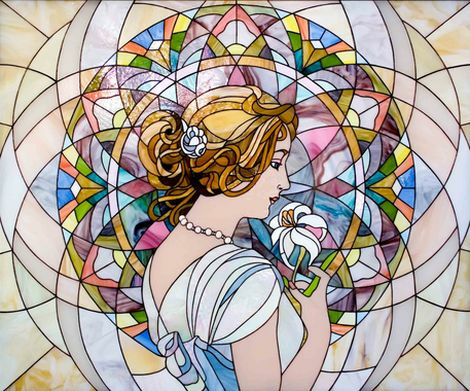
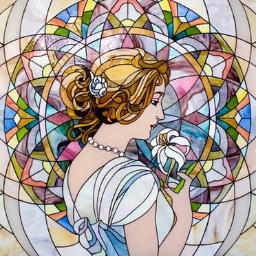

In [5]:
image_string = tf.io.read_file(STYLE_IMAGE_PATH)
style_image = fnstf_utils.ImageRecordDatasetFactory.image2tensor(image_string, normalize=False)
style_image_SQ = fnstf_utils.ImageRecordDatasetFactory.random_sq_crop(style_image, size=256)
show([style_image, style_image_SQ], domain=(0,255), w=256)  


# style_image = style_image_SQ

In [0]:
def use_checkpoints_and_tboard():
  """Save checkpoints to google Drive using symbolic link """
  if os.path.isdir('/content/drive'):
    check_if_link = !ls -al /content/checkpoint
    print("saving checkpoint to google drive...")
    if check_if_link[0].find('/content/drive/')<0:
      dest = os.path.dirname(SAVE_MODEL_PATH)
      print("dest", dest)
      old = "{}_0".format(dest)
      !mv $dest $old
      !ln -s '/content/drive/My Drive/checkpoints' $dest
  # launch tensorboard
  ROOT = %pwd
  colab_utils.tboard.launch_tensorboard( bin_dir=ROOT, log_dir=LOG_PATH )

if not os.path.isdir(SAVE_MODEL_PATH): os.makedirs(SAVE_MODEL_PATH)
# use_checkpoints_and_tboard()

# Tensorflow implementation


## preflight checks

In [7]:
# TransformerNetwork.trainable_weights
transformerNetwork_VGG = tf_transformer.TransformerNetwork_VGG(style_image, batch_size=BATCH_SIZE)
check = transformerNetwork_VGG.transformer
print(check, check.trainable_weights) 
check.build(input_shape=(None,256,256,3))
check.summary()

<fast_neural_style_pytorch.tensorflow.transformer.TransformerNetwork object at 0x7fbd31537470> []
Model: "transformer_network"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv_1 (ConvLayer)           multiple                  7808      
_________________________________________________________________
conv_2 (ConvLayer)           multiple                  18496     
_________________________________________________________________
conv_3 (ConvLayer)           multiple                  73856     
_________________________________________________________________
residual_1 (ResidualLayer)   multiple                  295168    
_________________________________________________________________
residual_2 (ResidualLayer)   multiple                  295168    
_________________________________________________________________
residual_3 (ResidualLayer)   multiple                  295168    
_______________

In [8]:
# see: https://github.com/keras-team/keras-applications/blob/master/keras_applications/vgg16.py
vgg = transformerNetwork_VGG.vgg.loss_model
vgg.build(input_shape=(None,256,256,3))
vgg.summary()

Model: "vgg__model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg_layers (Model)           [(None, 16, 16, 512), (No 15304768  
Total params: 15,304,768
Trainable params: 0
Non-trainable params: 15,304,768
_________________________________________________________________


## prepare `TFRecordDataset`

count= 1000 , size= 16667571



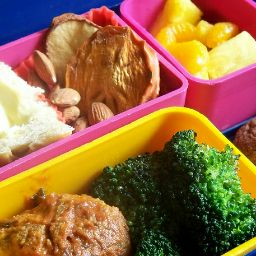
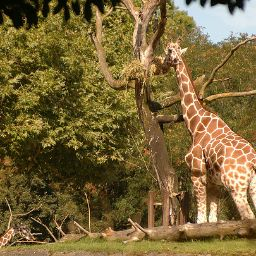
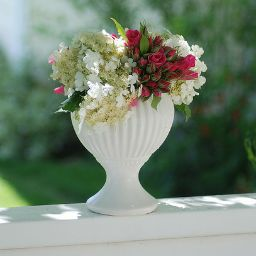
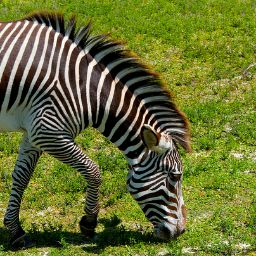

In [9]:
RecordsetHelper = fnstf_utils.ImageRecordDatasetFactory
rec_dataset = tf.data.TFRecordDataset(RECORD_PATH) # /content/coco2014-sq-1000.tfrecord
count = rec_dataset.reduce(0, lambda x, _: x + 1)
print("count=",count.numpy(), ", size=", os.path.getsize(RECORD_PATH))

image_ds_255 = rec_dataset.map(
    RecordsetHelper.example_parser(image2tensor=True, normalize=False)
)
setattr(image_ds_255,'count', count)
check = [d['image'] for d in image_ds_255.take(4)]
show(check, w=128, domain=(0,255))

tensor_ds_255 = image_ds_255.map(lambda d: d['image'])

### COCO2014 dataset

In [10]:
def getSqImage(filepath):
  image_string = tf.io.read_file(filepath)
  img = RecordsetHelper.image2tensor(image_string, normalize=False)
  img = RecordsetHelper.random_sq_crop(img, margin_pct=10)
  img = tf.floor(img) # for normalize=False, domain=(0.,255.)
  return img

list_ds = tf.data.Dataset.list_files('{}/*/*'.format(DATASET_PATH), shuffle=False, seed=1)

# `coco2014_tensor_ds` is a dataset of image tensors
coco2014_tensor_ds = list_ds.map(getSqImage)
setattr(coco2014_tensor_ds, 'count', fnstf_utils.dataset_size(list_ds))
print("coco2014_ds count=", coco2014_tensor_ds.count)


coco2014_ds count= 82783


In [0]:
# losses: see also, fnstf_utils.get_SUM_mse_loss()
MSELoss = tf.keras.losses.MSE
# works for both style and content losses
def get_MEAN_mse_loss(y_true, y_pred, weights=None):
  if isinstance(y_pred, (tuple, list)):
    if weights is not None:
      assert len(weights)==len(y_pred), "weights do not match"
      losses = [ get_MEAN_mse_loss(y_true, y_pred, w) for (y_true, y_pred, w) in zip(y_true, y_pred, weights) ]
    else:
      losses = [ get_MEAN_mse_loss(y_true, y_pred, None) for (y_true, y_pred) in zip(y_true, y_pred) ]
    return tf.reduce_mean(losses)
  if tf.is_tensor(y_pred):
    batch_size = y_pred.shape[0]
    weights = weights or 1.
    return tf.reduce_mean(MSELoss(y_true[:batch_size], y_pred)) * weights
  assert False, "unexpected input"


## `keras.callbacks`

In [0]:
class SnapshotCallback(tf.keras.callbacks.Callback):
  def __init__(self, validation_images, model=None, stacker=None, 
        log_after_batch=None, 
        save_image_path=None,
        epoch_offset=0, 
        ):
    super(SnapshotCallback, self).__init__()

    # convert validation images to batch of images
    if isinstance(validation_images, (tuple, list)):
      validation_images = tf.stack(validation_images, axis=0)
    elif isinstance(validation_images, tf.data.Dataset):
      validation_images = next(iter(validation_images))
    assert tf.is_tensor(validation_images), "ERROR: expecting a list or batch of images, got {}".format(validation_images)
    if len(validation_images.shape)==3: validation_images = validation_images[tf.newaxis, ...]
    b,h,w,c = validation_images.shape

    self.images = validation_images # batch of images
    self.cur_index = 0
    self.model = model
    self.stacker = stacker if stacker is not None else helpers.ImgStacker()
    self.offset = epoch_offset
    self.batch = 0        # step in current epoch
    self.iteration = 0  # same as opt.iterations
    self.log_after_batch=log_after_batch
    self.save_image_path=save_image_path

  def getImage(self):
    i = self.cur_index
    self.cur_index += 1
    img = self.images[i:self.cur_index]
    if self.cur_index >= self.images.shape[0]: self.cur_index = 0
    return img

  def show_latest(self):
    show( self.stacker.hstack(), w=128, domain=(0,255))
    return

  def push_latest(self):
    if self.stacker is not None:
      input_batch = self.getImage()
      _transformer = self.model.transformer if hasattr(self.model, 'transformer') else self.model
      generated_image = _transformer(input_batch)
      rgb_image = tf.squeeze(generated_image).numpy() # 255.
      rgb_clipped = rgb_image.clip(0.,255.)
      check = self.stacker.hstack( rgb_clipped, limit=10 )
      show( check, domain=None )

  def save_latest(self, count):
    if self.stacker is not None and self.save_image_path is not None:
      # save generated image history
      try:
        filepath = os.path.join(self.save_image_path , "tf_sample_{}.png".format(count))
        save( self.stacker.hstack(), filepath)
        # im=Image.fromarray(np.uint8(self.stacker.hstack()))
        # im.save(filepath)
      except:
        pass

  def on_batch_end(self, batch, logs=None):
    # on_batch_end: logs include `loss`, and optionally `acc`
    # logs = logs or {}
    first = batch==0
    self.batch = np.maximum(batch, self.batch)
    if self.log_after_batch is not None and batch % self.log_after_batch==0:
      self.push_latest()
      if logs and hasattr(logs,'loss'):
        print('For batch {}, loss is {:7.2f}.'.format(batch, logs['loss']))
      if not first and batch % (self.log_after_batch*10):
        self.save_latest(batch)

  def on_epoch_end(self, epoch, logs=None):
    # on_epoch_end: logs include `acc` and `loss`, and optionally include `val_loss` (if validation is enabled in `fit`), and `val_acc`
    # logs = logs or {}
    # epoch is 0-based
    num_batches = self.batch
    self.iteration += num_batches
    self.batch = 0 # reset for next epoch

    overall = self.offset + self.iteration
    if self.log_after_batch is None or overall % num_batches ==0:
      self.push_latest() 
      self.save_latest(overall)


In [0]:
class HistoryCallback(tf.keras.callbacks.Callback):
  """ emulate history = model.fit() output 
  usage: 
    history = HistoryCallback()
    losses = history.history() or history.history(as_dict=True)
  """
  def __init__(self, stash=None):
    super(HistoryCallback, self).__init__()
    self._batches = None 
    self._epochs = None
    self.stash = stash
    self.FROM_MODEL_FIT = False
    self.HAS_TOTAL_LOSS = False
    self.IS_GPU = tf.test.gpu_device_name() == '/device:GPU:0'

  def on_batch_end(self, batch, logs=None, losses=None):
    if losses is None and logs is not None:
      # logs: 
      #   batch <class 'int'>
      #   size <class 'numpy.int64'>
      #   loss <class 'numpy.float32'>
      #   output_1_loss <class 'numpy.float32'>
      #   output_2_loss <class 'numpy.float32'>
      #   output_3_loss <class 'numpy.float32'>
      #   output_4_loss <class 'numpy.float32'>
      #   output_5_loss <class 'numpy.float32'>
      #   output_6_loss <class 'numpy.float32'>
      keys = [k for k in logs.keys() if k.endswith("loss")]
      losses = [logs[k] for k in keys]
      self.FROM_MODEL_FIT = 'batch' in logs and 'size' in logs

    losses = tf.expand_dims(losses, 0) 
    self._batches = losses if self._batches is None else tf.concat( [self._batches, losses], axis=0 )

    # if batch==0 and len(self._epochs)==0: 
    if batch==0 and self._epochs is None: 
      self.on_epoch_end(0)              # count batch=0 as epoch=0, but don't reset self._batches

    if self.FROM_MODEL_FIT and 'loss' in logs: # model.fit(), loss=reduce_mean(logs['loss']), but just multiple losses are for just the batch
      cumulative_batch_losses = tf.reduce_mean(self._batches[:,0]) # reduce_mean only "total_loss"
      self.HAS_TOTAL_LOSS = True
      start_from = 1 # skip logs['loss']
    else:
      cumulative_batch_losses = tf.reduce_mean(tf.reduce_sum(self._batches, axis=1)) # shape=(NUM_BATCHES,6)  
      start_from = 0

    if self.IS_GPU==True and batch%250!=0:
      return


    # log results
    # i, *lossCount = self._batches.shape
    # startFrom = start_from if lossCount[-1]>1 else 0 # skip 'loss' when multiple outputs
    most_recent_losses = tf.squeeze(self._batches[-1, ..., :])
    log_output = "\tbatch: {} >>> loss: {}, batch losses: {}".format(
        self._batches.shape[0], 
        cumulative_batch_losses.numpy(), 
        most_recent_losses.numpy() )
    if self.FROM_MODEL_FIT:
      log_output = '\n' + log_output
    print(log_output)

    return self._batches.shape[0]

  def on_epoch_end(self, epoch, logs=None):
    if self._batches is None:
      return
    """epoch losses are reduce_mean(batch_losses)"""
    cur_epoch_losses = tf.reduce_mean(self._batches, axis=0) # shape=(NUM_BATCHES,6)  
    # self._epochs.append( cur_epoch_losses.numpy() ) # list of ndarray
    cur_epoch_losses = tf.expand_dims(cur_epoch_losses, 0) 
    self._epochs = cur_epoch_losses if self._epochs is None else tf.concat( [self._epochs, cur_epoch_losses], axis=0 )

    # if len(self._epochs)==1: 
    if self._epochs.shape[0] > 1:
      # first row is for reporting only, do NOT reset self._batches
      self._batches=None

    print("epoch: {} >>> loss: {}\n".format(len(self._epochs)-1, tf.squeeze(cur_epoch_losses).numpy()) )
    return cur_epoch_losses

  def history(self, as_dict=False, prefix="output_loss"):
    # if len(self._epochs)==0:
    if self._epochs is None:
      print("History.history() returns batch losses")
      losses = self._batches # shape=(NUM_BATCHES,6)
    else:
      print("History.history() returns epoch losses")
      losses = self._epochs # shape=(NUM_EPOCHS,6)
    if not as_dict: return losses

    # format as dict
    result = {}
    rows, cols = losses.shape
    for c in range(cols):
      if self.HAS_TOTAL_LOSS:
        key_prefix = "loss" if c==0 else prefix
      else:
        key_prefix = prefix

      key = "{}_{}".format(key_prefix, c)
      result[key] = losses[:,c]
    return result


In [0]:
class CheckpointCallback(tf.keras.callbacks.Callback):
  """ save checkpoints on a fixed schedule
  """
  def __init__(self, model, filepath):
    super(CheckpointCallback, self).__init__()
    self.model = model
    self.checkpoint_path = filepath
    assert os.path.isdir(os.path.dirname(filepath)) , "ERROR: parent dir missing, path={}".format(filepath)

  def save_weights(self, suffix):
    _transformer = self.model.transformer if hasattr(self.model, 'transformer') else self.model
    filepath = "{}_{}.h5".format(self.checkpoint_path,suffix)
    _transformer.save_weights(filepath, save_format='h5')
    return filepath
    
  def on_batch_end(self, batch, logs=None):
    if batch>0 and batch%2000==0:
      fname = self.save_weights("step_{}".format(batch))
      print("\n>>> saving checkpoint={}\n ".format(os.path.basename(fname)) )

    # something funny happens around step 3500  
    elif batch>3200 and batch<4000 and batch%100==0:
      fname = self.save_weights("step_{}".format(batch))
      print("\n>>> saving checkpoint={}\n ".format(os.path.basename(fname)) )


  def on_epoch_end(self, epoch, logs=None):
    fname = self.save_weights("epoch_{}".format(epoch))
    print("\n>>> saving checkpoint={}\n ".format(os.path.basename(fname)) )
    return
    

# checkpoint_path = os.path.join(SAVE_MODEL_PATH, "tf_checkpoint")
# Checkpoints = CheckpointCallback(TransformerNetwork_VGG, checkpoint_path)
# Checkpoints.save_weights(270)

# Transformer network with VGG output



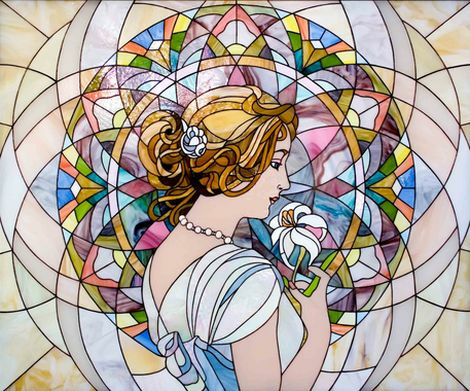

In [15]:
transformerNetwork_VGG = tf_transformer.TransformerNetwork_VGG(style_image, batch_size=BATCH_SIZE)
get_MEAN_mse_loss = fnstf_utils.get_MEAN_mse_loss
style_image = transformerNetwork_VGG.vgg.style_image
show([style_image], labels=["style_image, shape={}".format(style_image.shape)], w=128, domain=(0.,255.) )

tensor_ds_255 = coco2014_tensor_ds


### `y_true` generator with Transformer_VGG

In [16]:
# # get y_true from generator
def BATCH_xyGenerator_y_true_as_features_and_weights(tensor_ds_255, 
                                                     VGGfeatures,
                                                     feature_weights=None
                                                     ):
  """ returns generator with weights(x_train, y_true, weights)
  """

  if feature_weights is not None: print("dataset generator using FEATURE_WEIGHTS=", feature_weights)
  
  def gen():
    weights = tuple( [v] for v in feature_weights) if feature_weights else tuple( [1.] for v in range(6))
    for x_train in tensor_ds_255.batch(BATCH_SIZE):
      batch = x_train if len(x_train.shape)==4 else x_train[tf.newaxis,...]
      y_true_features = VGGfeatures.get_y_true(batch)
      yield (x_train, y_true_features, weights)

  output_types= (
      tf.float32,    
      ( 
        tf.float32,       tf.float32, tf.float32, tf.float32, tf.float32, tf.float32
      ),
      (tf.float32,       tf.float32, tf.float32, tf.float32, tf.float32, tf.float32)
  )

  output_shapes = ( 
      (None, 256,256,3),
      (
        (None, 16, 16, 512),
        (None, 64, 64), (None, 128, 128), (None, 256, 256), (None, 512, 512), (None, 512, 512)
      ),
      (
          (1,),     (1,),(1,),(1,),(1,),(1,)
      )
  )
  return tf.data.Dataset.from_generator(
                                      generator=gen, 
                                      output_types=output_types, 
                                      output_shapes=output_shapes,
                                    )

reduce_sum_FEATURE_WEIGHTS = [31.51, 823.95 , 33.20, 44.95, 1.1, 1889.85 ]
reduce_mean_FEATURE_WEIGHTS = [34.34, 872.6, 32.4, 44.65, 1.1, 2099.35]
ONES = [1.,1.,1.,1.,1.,1.,]
FEATURE_WEIGHTS = ONES

BATCH_xy_Dataset255_with_features = BATCH_xyGenerator_y_true_as_features_and_weights(
    tensor_ds_255, 
    transformerNetwork_VGG.vgg,
    feature_weights=FEATURE_WEIGHTS)



dataset generator using FEATURE_WEIGHTS= [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


# Keras Standard training, `model.fit()` 

In [29]:
use_checkpoints_and_tboard()

saving checkpoint to google drive...
ngrok installed
status: tensorboard=False, ngrok=True
tensorboard url= http://db5b4fba.ngrok.io


## train


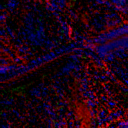

dataset generator using FEATURE_WEIGHTS= [19.83, 2209.59, 24.08, 7.41, 1.3, 2303.04]
Train for 20695.75 steps
Epoch 1/2



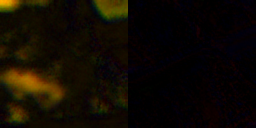

epoch: 0 >>> loss: [20247858.     101869.03  6878129.    5678755.5   1830513.    5471404.5
   287185.03]


	batch: 1 >>> loss: 20247858.0, batch losses: [20247858.     101869.03  6878129.    5678755.5   1830513.    5471404.5
   287185.03]
  100/20695 [..............................] - ETA: 5:33:48 - loss: 10461403.2900 - output_1_loss: 124109.5703 - output_2_loss: 1058021.2500 - output_3_loss: 2896014.7500 - output_4_loss: 1624244.1250 - output_5_loss: 4353856.5000 - output_6_loss: 405159.2812


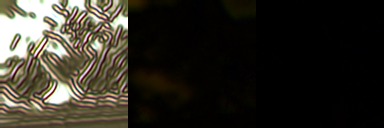

  200/20695 [..............................] - ETA: 5:23:52 - loss: 7757663.2325 - output_1_loss: 130868.4062 - output_2_loss: 623184.7500 - output_3_loss: 1913618.1250 - output_4_loss: 1317114.8750 - output_5_loss: 3365626.0000 - output_6_loss: 407251.6875


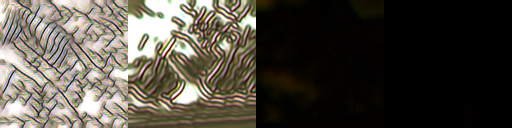

  250/20695 [..............................] - ETA: 5:21:26 - loss: 6696502.4885 - output_1_loss: 130327.7500 - output_2_loss: 516608.2812 - output_3_loss: 1614881.8750 - output_4_loss: 1150631.6250 - output_5_loss: 2905128.2500 - output_6_loss: 378923.9688
	batch: 251 >>> loss: 6678240.5, batch losses: [2112799.5   130275.67  514792.78 1609976.4  1147764.5  2896989.
  378441.66]
  300/20695 [..............................] - ETA: 5:19:29 - loss: 5877754.0000 - output_1_loss: 129409.2031 - output_2_loss: 441847.7812 - output_3_loss: 1395987.6250 - output_4_loss: 1015285.8750 - output_5_loss: 2541401.2500 - output_6_loss: 353820.8750


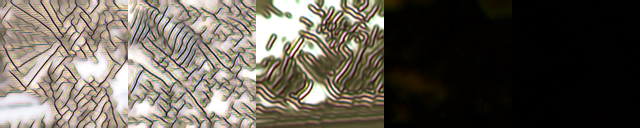

  400/20695 [..............................] - ETA: 5:16:42 - loss: 4730300.5536 - output_1_loss: 126853.7266 - output_2_loss: 344802.9688 - output_3_loss: 1096908.5000 - output_4_loss: 816054.8125 - output_5_loss: 2031369.5000 - output_6_loss: 314310.1875


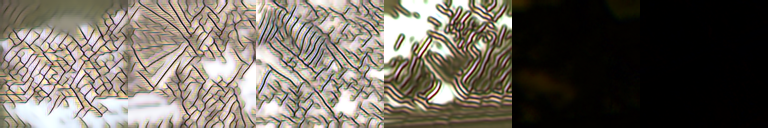

  500/20695 [..............................] - ETA: 5:14:18 - loss: 3978360.6209 - output_1_loss: 125228.0312 - output_2_loss: 284533.8750 - output_3_loss: 906091.3750 - output_4_loss: 684310.5625 - output_5_loss: 1694372.2500 - output_6_loss: 283823.8438


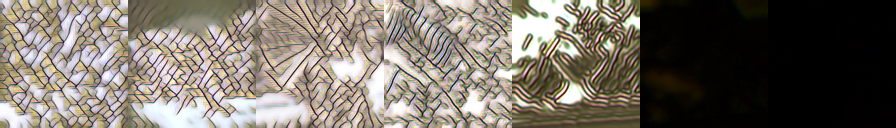


	batch: 501 >>> loss: 3972350.0, batch losses: [ 966973.5   125261.17  284051.2   904558.94  683242.4  1691677.4
  283558.22]
  600/20695 [..............................] - ETA: 5:12:09 - loss: 3457753.6157 - output_1_loss: 124098.5703 - output_2_loss: 243815.7812 - output_3_loss: 775690.2500 - output_4_loss: 592665.1875 - output_5_loss: 1461192.6250 - output_6_loss: 260290.7188


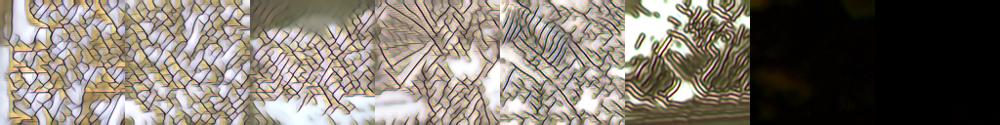

  700/20695 [>.............................] - ETA: 5:10:12 - loss: 3072282.9446 - output_1_loss: 123288.8203 - output_2_loss: 214148.3594 - output_3_loss: 679714.6875 - output_4_loss: 524303.3125 - output_5_loss: 1288753.5000 - output_6_loss: 242073.5781


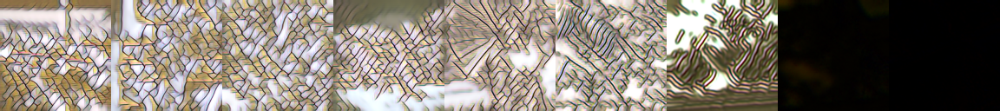

  750/20695 [>.............................] - ETA: 5:09:18 - loss: 2914225.5316 - output_1_loss: 122984.5938 - output_2_loss: 202224.6875 - output_3_loss: 640476.0000 - output_4_loss: 496076.7188 - output_5_loss: 1218119.5000 - output_6_loss: 234342.8906
	batch: 751 >>> loss: 2911234.0, batch losses: [ 667816.94  122951.14  201991.69  639736.44  495543.72 1216802.
  234208.17]
  800/20695 [>.............................] - ETA: 5:08:24 - loss: 2773867.3394 - output_1_loss: 123037.8906 - output_2_loss: 191282.5938 - output_3_loss: 605597.5625 - output_4_loss: 470928.6250 - output_5_loss: 1155619.5000 - output_6_loss: 227399.7969


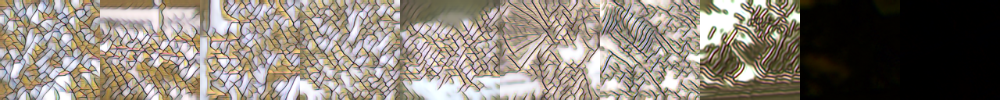

  900/20695 [>.............................] - ETA: 5:06:38 - loss: 2533778.8117 - output_1_loss: 123031.7266 - output_2_loss: 173015.3281 - output_3_loss: 546102.3125 - output_4_loss: 427708.1562 - output_5_loss: 1049025.8750 - output_6_loss: 214894.0938


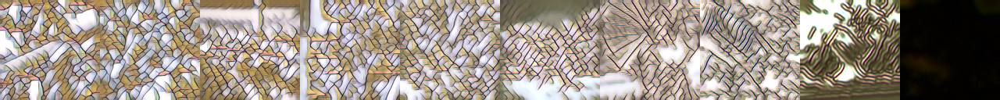

 1000/20695 [>.............................] - ETA: 5:04:58 - loss: 2335947.1107 - output_1_loss: 122880.8594 - output_2_loss: 157818.4219 - output_3_loss: 497299.2812 - output_4_loss: 391967.4062 - output_5_loss: 961887.2500 - output_6_loss: 204092.6250


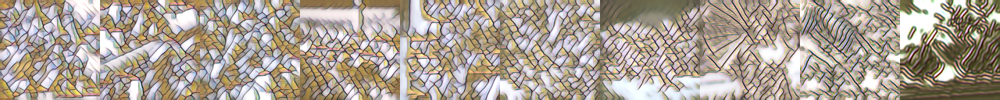


	batch: 1001 >>> loss: 2334163.0, batch losses: [549836.5  122875.32 157692.3  496857.22 391641.22 961097.06 203998.36]
 1100/20695 [>.............................] - ETA: 5:03:16 - loss: 2170344.9285 - output_1_loss: 122724.1172 - output_2_loss: 145144.7188 - output_3_loss: 456714.0312 - output_4_loss: 361922.5938 - output_5_loss: 889109.5000 - output_6_loss: 194728.8594


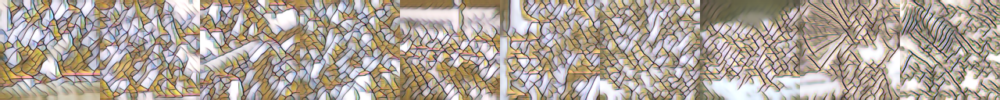

 1200/20695 [>.............................] - ETA: 5:01:34 - loss: 2030046.4229 - output_1_loss: 122675.0391 - output_2_loss: 134555.0000 - output_3_loss: 422661.9062 - output_4_loss: 336354.2812 - output_5_loss: 827397.4375 - output_6_loss: 186401.7031


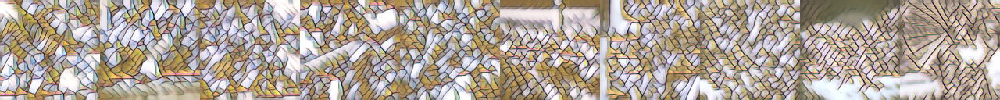

 1250/20695 [>.............................] - ETA: 5:00:45 - loss: 1967757.8374 - output_1_loss: 122699.1875 - output_2_loss: 129927.9844 - output_3_loss: 407670.8125 - output_4_loss: 324927.8438 - output_5_loss: 799943.2500 - output_6_loss: 182587.8594
	batch: 1251 >>> loss: 1966590.375, batch losses: [507367.2  122724.58 129837.91 407383.1  324710.9  799418.1  182514.9 ]
 1300/20695 [>.............................] - ETA: 4:59:55 - loss: 1909521.1274 - output_1_loss: 122712.3438 - output_2_loss: 125543.2734 - output_3_loss: 393618.9375 - output_4_loss: 314290.9688 - output_5_loss: 774353.4375 - output_6_loss: 179001.4062


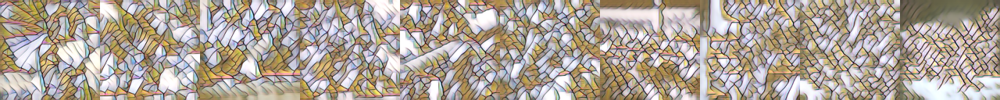

 1400/20695 [=>............................] - ETA: 4:58:20 - loss: 1804868.8665 - output_1_loss: 122670.5703 - output_2_loss: 117638.2734 - output_3_loss: 368440.5312 - output_4_loss: 295156.1250 - output_5_loss: 728486.4375 - output_6_loss: 172476.0469


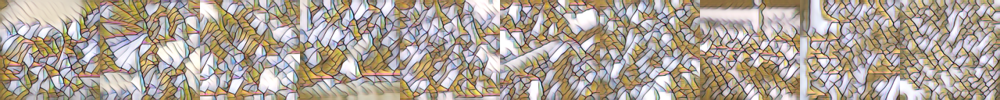

 1500/20695 [=>............................] - ETA: 4:56:41 - loss: 1712660.2742 - output_1_loss: 122863.9922 - output_2_loss: 110660.0547 - output_3_loss: 346271.3750 - output_4_loss: 278270.2500 - output_5_loss: 688055.0625 - output_6_loss: 166538.3438


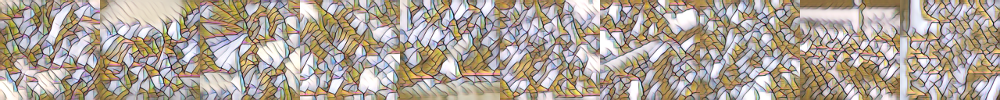


	batch: 1501 >>> loss: 1711805.625, batch losses: [429802.56 122865.37 110593.75 346065.84 278112.3  687680.5  166486.62]
 1600/20695 [=>............................] - ETA: 4:55:03 - loss: 1631614.0566 - output_1_loss: 122884.2969 - output_2_loss: 104596.4688 - output_3_loss: 326979.2500 - output_4_loss: 263420.4688 - output_5_loss: 652552.1250 - output_6_loss: 161179.8438


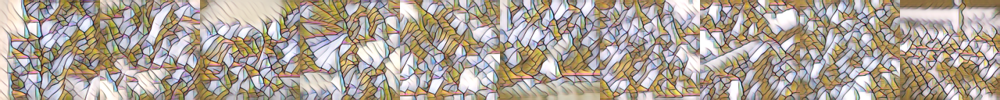

 1700/20695 [=>............................] - ETA: 4:53:21 - loss: 1559556.4694 - output_1_loss: 122694.3516 - output_2_loss: 99352.6016 - output_3_loss: 309941.0312 - output_4_loss: 250238.4531 - output_5_loss: 621040.8750 - output_6_loss: 156287.5156


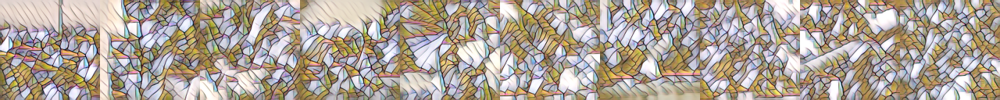

 1750/20695 [=>............................] - ETA: 4:52:33 - loss: 1526162.1966 - output_1_loss: 122742.8203 - output_2_loss: 96867.6406 - output_3_loss: 302018.0938 - output_4_loss: 244137.7812 - output_5_loss: 606402.8125 - output_6_loss: 153991.4531
	batch: 1751 >>> loss: 1525495.5, batch losses: [358756.44 122725.29  96817.81 301862.84 244018.81 606118.94 153950.2 ]
 1800/20695 [=>............................] - ETA: 4:51:43 - loss: 1494645.2531 - output_1_loss: 122784.7812 - output_2_loss: 94531.0391 - output_3_loss: 294515.7188 - output_4_loss: 238348.1562 - output_5_loss: 592622.5625 - output_6_loss: 151841.5469


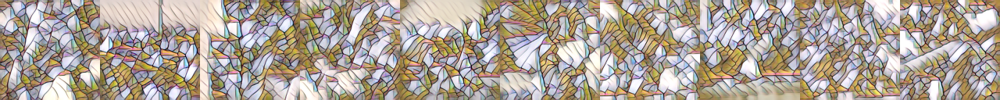

 1900/20695 [=>............................] - ETA: 4:50:05 - loss: 1436035.5941 - output_1_loss: 122959.1016 - output_2_loss: 90198.5781 - output_3_loss: 280699.6875 - output_4_loss: 227587.7031 - output_5_loss: 566902.3750 - output_6_loss: 147686.7656


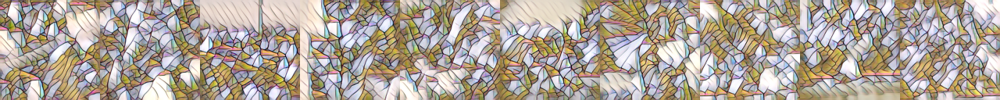

 2000/20695 [=>............................] - ETA: 4:48:28 - loss: 1383184.9170 - output_1_loss: 123399.0859 - output_2_loss: 86276.8906 - output_3_loss: 268220.3438 - output_4_loss: 217854.3594 - output_5_loss: 543568.3125 - output_6_loss: 143864.7500


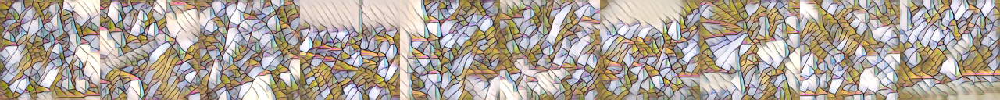


>>> saving checkpoint=full_coco2014_step_2000.h5
 

	batch: 2001 >>> loss: 1382709.125, batch losses: [431006.88 123422.34  86240.34 268102.6  217762.84 543350.56 143829.25]
 2100/20695 [==>...........................] - ETA: 4:46:52 - loss: 1334414.0049 - output_1_loss: 123536.9297 - output_2_loss: 82649.1719 - output_3_loss: 256762.9062 - output_4_loss: 208932.7031 - output_5_loss: 522221.5312 - output_6_loss: 140309.9844


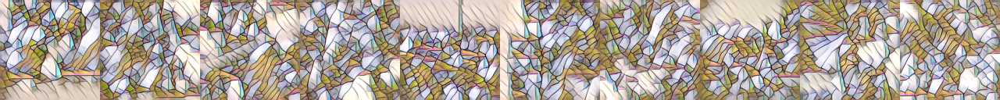

 2200/20695 [==>...........................] - ETA: 4:45:15 - loss: 1289922.9868 - output_1_loss: 123657.6016 - output_2_loss: 79376.8203 - output_3_loss: 246325.3594 - output_4_loss: 200766.6562 - output_5_loss: 502774.9375 - output_6_loss: 137020.7812


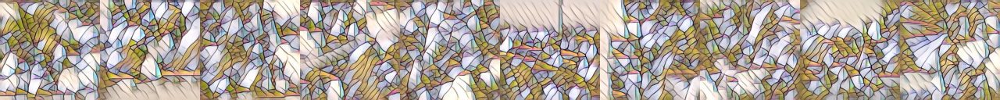

 2250/20695 [==>...........................] - ETA: 4:44:27 - loss: 1269300.0198 - output_1_loss: 123647.0625 - output_2_loss: 77898.8906 - output_3_loss: 241527.0469 - output_4_loss: 196971.6719 - output_5_loss: 493770.0000 - output_6_loss: 135484.4375
	batch: 2251 >>> loss: 1268891.375, batch losses: [349081.78 123649.58  77867.95 241431.52 196897.69 493590.47 135453.08]
 2300/20695 [==>...........................] - ETA: 4:43:38 - loss: 1249493.6863 - output_1_loss: 123622.8281 - output_2_loss: 76489.0312 - output_3_loss: 236926.6719 - output_4_loss: 193344.1875 - output_5_loss: 485107.8125 - output_6_loss: 134002.1562


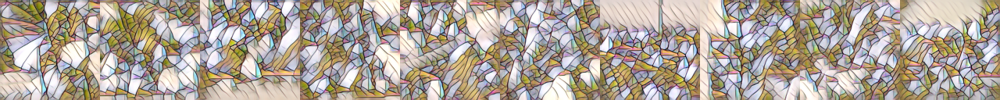

 2400/20695 [==>...........................] - ETA: 4:42:02 - loss: 1212062.5993 - output_1_loss: 123586.0000 - output_2_loss: 73785.9453 - output_3_loss: 228206.1875 - output_4_loss: 186475.1406 - output_5_loss: 468811.9062 - output_6_loss: 131196.3438


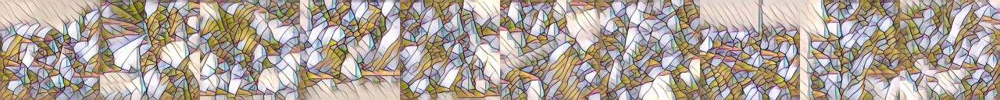

 2500/20695 [==>...........................] - ETA: 4:40:28 - loss: 1177316.1580 - output_1_loss: 123526.7188 - output_2_loss: 71222.8359 - output_3_loss: 220146.1250 - output_4_loss: 180150.4844 - output_5_loss: 453699.7500 - output_6_loss: 128569.0469


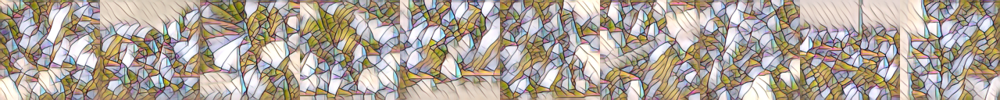


	batch: 2501 >>> loss: 1176976.25, batch losses: [327278.53 123527.46  71197.26 220067.31 180089.58 453550.88 128542.58]
 2600/20695 [==>...........................] - ETA: 4:38:52 - loss: 1145238.1168 - output_1_loss: 123565.1094 - output_2_loss: 68860.2500 - output_3_loss: 212659.0938 - output_4_loss: 174293.0625 - output_5_loss: 439752.7500 - output_6_loss: 126106.5625


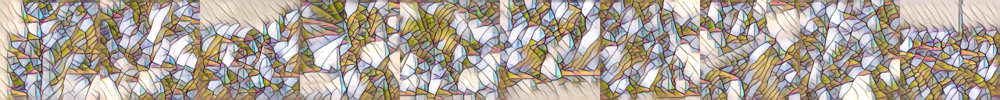

 2700/20695 [==>...........................] - ETA: 4:37:18 - loss: 1115193.3844 - output_1_loss: 123599.2656 - output_2_loss: 66693.7891 - output_3_loss: 205690.9531 - output_4_loss: 168785.9375 - output_5_loss: 426650.2188 - output_6_loss: 123772.0859


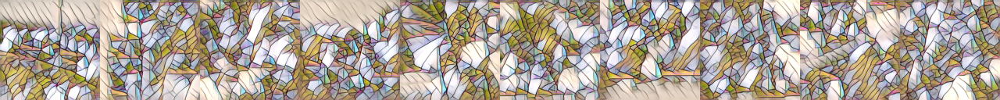

 2750/20695 [==>...........................] - ETA: 4:36:32 - loss: 1100884.3831 - output_1_loss: 123633.4297 - output_2_loss: 65640.7422 - output_3_loss: 202378.1250 - output_4_loss: 166173.7969 - output_5_loss: 420400.7188 - output_6_loss: 122656.1016
	batch: 2751 >>> loss: 1100594.25, batch losses: [302809.12 123628.03  65621.09 202313.14 166121.33 420276.22 122633.02]
 2800/20695 [===>..........................] - ETA: 4:35:44 - loss: 1087047.9277 - output_1_loss: 123633.8516 - output_2_loss: 64654.1719 - output_3_loss: 199210.4844 - output_4_loss: 163635.3906 - output_5_loss: 414348.3750 - output_6_loss: 121564.2031


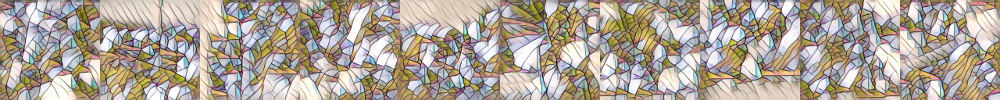

 2900/20695 [===>..........................] - ETA: 4:34:10 - loss: 1060849.8472 - output_1_loss: 123691.4062 - output_2_loss: 62758.8516 - output_3_loss: 193157.1250 - output_4_loss: 158826.2031 - output_5_loss: 402932.2188 - output_6_loss: 119482.2812


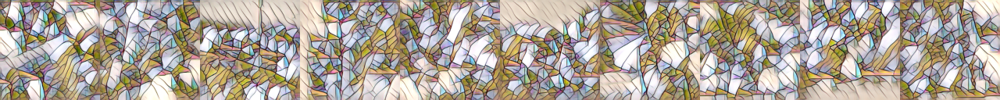

 3000/20695 [===>..........................] - ETA: 4:32:35 - loss: 1036722.5880 - output_1_loss: 123748.3828 - output_2_loss: 61061.1250 - output_3_loss: 187635.0781 - output_4_loss: 154373.2344 - output_5_loss: 392359.3438 - output_6_loss: 117543.6250


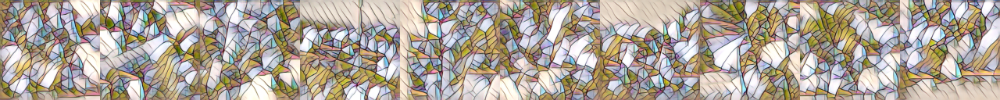


	batch: 3001 >>> loss: 1036493.75, batch losses: [349919.03 123763.49  61043.66 187580.08 154329.55 392252.6  117522.55]
 3100/20695 [===>..........................] - ETA: 4:31:02 - loss: 1013770.4417 - output_1_loss: 123881.4141 - output_2_loss: 59368.9375 - output_3_loss: 182321.6562 - output_4_loss: 150166.5781 - output_5_loss: 382332.0625 - output_6_loss: 115698.1484


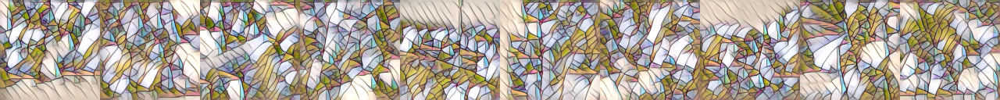

 3200/20695 [===>..........................] - ETA: 4:29:28 - loss: 991744.5524 - output_1_loss: 123906.9688 - output_2_loss: 57745.6758 - output_3_loss: 177256.2031 - output_4_loss: 146163.5000 - output_5_loss: 372761.7500 - output_6_loss: 113909.0469


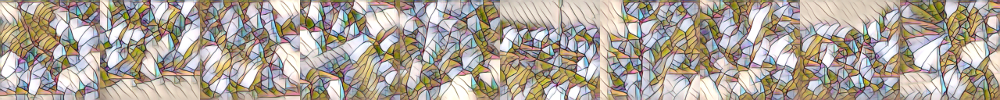

 3250/20695 [===>..........................] - ETA: 4:28:42 - loss: 981491.8973 - output_1_loss: 123910.6484 - output_2_loss: 57019.7227 - output_3_loss: 174934.0781 - output_4_loss: 144277.1250 - output_5_loss: 368291.6562 - output_6_loss: 113057.3750
	batch: 3251 >>> loss: 981287.4375, batch losses: [316767.8  123906.17  57006.58 174889.48 144239.92 368203.28 113040.71]
 3300/20695 [===>..........................] - ETA: 4:27:55 - loss: 971686.6696 - output_1_loss: 123918.9062 - output_2_loss: 56337.2891 - output_3_loss: 172708.2031 - output_4_loss: 142464.1406 - output_5_loss: 364006.7188 - output_6_loss: 112250.0469


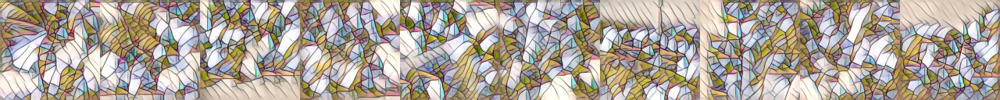


>>> saving checkpoint=full_coco2014_step_3300.h5
 
 3400/20695 [===>..........................] - ETA: 4:26:22 - loss: 953168.7218 - output_1_loss: 123929.1953 - output_2_loss: 55090.2109 - output_3_loss: 168500.2344 - output_4_loss: 139039.1250 - output_5_loss: 355890.0312 - output_6_loss: 110718.5781


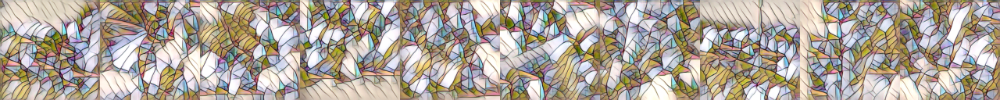


>>> saving checkpoint=full_coco2014_step_3400.h5
 
 3500/20695 [====>.........................] - ETA: 4:24:48 - loss: 935344.0219 - output_1_loss: 124042.5938 - output_2_loss: 53807.3516 - output_3_loss: 164373.4844 - output_4_loss: 135753.5938 - output_5_loss: 348085.6250 - output_6_loss: 109280.0469


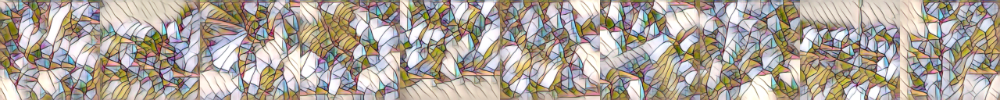


>>> saving checkpoint=full_coco2014_step_3500.h5
 

	batch: 3501 >>> loss: 935162.5625, batch losses: [300253.3  124039.68  53794.17 164331.75 135721.02 348007.97 109266.7 ]
 3600/20695 [====>.........................] - ETA: 4:23:14 - loss: 918017.2146 - output_1_loss: 124055.9922 - output_2_loss: 52535.9062 - output_3_loss: 160401.0469 - output_4_loss: 132601.0156 - output_5_loss: 340561.5938 - output_6_loss: 107860.3047


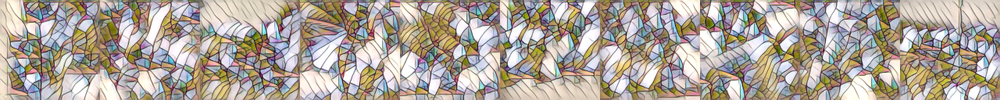


>>> saving checkpoint=full_coco2014_step_3600.h5
 
 3700/20695 [====>.........................] - ETA: 4:21:41 - loss: 901454.0553 - output_1_loss: 124096.1328 - output_2_loss: 51326.8672 - output_3_loss: 156607.0312 - output_4_loss: 129584.2578 - output_5_loss: 333345.5312 - output_6_loss: 106493.0781


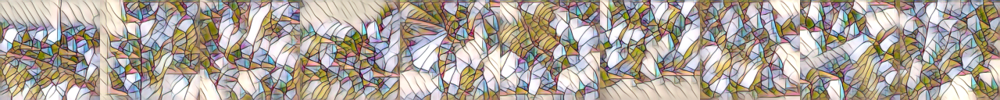


>>> saving checkpoint=full_coco2014_step_3700.h5
 
 3750/20695 [====>.........................] - ETA: 4:20:55 - loss: 893397.4667 - output_1_loss: 124108.4531 - output_2_loss: 50735.1992 - output_3_loss: 154768.8281 - output_4_loss: 128128.1953 - output_5_loss: 329850.2188 - output_6_loss: 105805.6250
	batch: 3751 >>> loss: 893240.0625, batch losses: [302741.12 124110.49  50723.46 154733.64 128099.09 329780.6  105791.8 ]
 3800/20695 [====>.........................] - ETA: 4:20:07 - loss: 1044768.7239 - output_1_loss: 123897.2188 - output_2_loss: 101063.2812 - output_3_loss: 200778.2812 - output_4_loss: 141584.6875 - output_5_loss: 370377.5000 - output_6_loss: 107066.7812


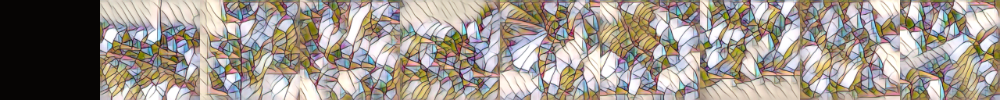


>>> saving checkpoint=full_coco2014_step_3800.h5
 
 3900/20695 [====>.........................] - ETA: 4:18:33 - loss: 1479362.4735 - output_1_loss: 123050.9766 - output_2_loss: 200276.5156 - output_3_loss: 356414.2188 - output_4_loss: 185420.0781 - output_5_loss: 502506.7500 - output_6_loss: 111692.8750


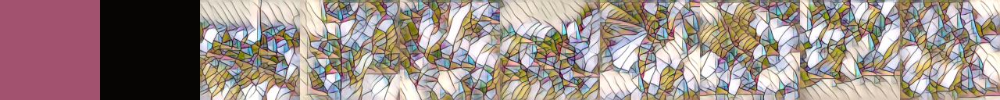


>>> saving checkpoint=full_coco2014_step_3900.h5
 
 4000/20695 [====>.........................] - ETA: 4:16:59 - loss: 1851672.5189 - output_1_loss: 122296.6562 - output_2_loss: 255547.5781 - output_3_loss: 503241.7500 - output_4_loss: 226896.6562 - output_5_loss: 627673.1875 - output_6_loss: 116015.4922


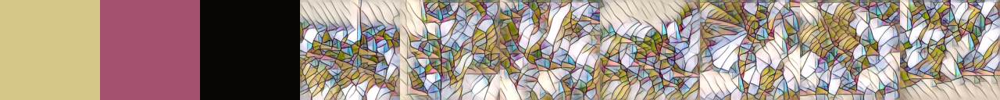


>>> saving checkpoint=full_coco2014_step_4000.h5
 

	batch: 4001 >>> loss: 1855281.5, batch losses: [16290838.     122296.95   256070.66   504671.38   227299.81   628884.25
   116057.24]
 4100/20695 [====>.........................] - ETA: 4:15:24 - loss: 2198483.9265 - output_1_loss: 121648.7344 - output_2_loss: 300641.0000 - output_3_loss: 643743.7500 - output_4_loss: 266300.5625 - output_5_loss: 746039.8125 - output_6_loss: 120108.8750


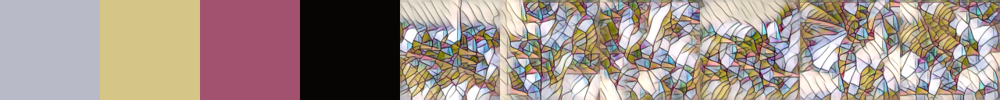

 4200/20695 [=====>........................] - ETA: 4:13:50 - loss: 2522112.9711 - output_1_loss: 121086.7656 - output_2_loss: 340622.3438 - output_3_loss: 774311.6875 - output_4_loss: 303719.2812 - output_5_loss: 858355.7500 - output_6_loss: 124016.6641


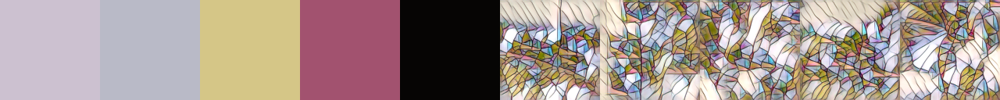

 4250/20695 [=====>........................] - ETA: 4:13:03 - loss: 2677358.0477 - output_1_loss: 120754.3906 - output_2_loss: 358944.5938 - output_3_loss: 837447.3750 - output_4_loss: 321772.2500 - output_5_loss: 912537.4375 - output_6_loss: 125901.5000
	batch: 4251 >>> loss: 2680426.75, batch losses: [15723824.     120745.79   359350.44   838663.7    322127.5    913600.44
   125938.62]
 4287/20695 [=====>........................] - ETA: 4:12:28 - loss: 2789735.7944 - output_1_loss: 120542.3594 - output_2_loss: 371875.9688 - output_3_loss: 883379.8750 - output_4_loss: 334862.0312 - output_5_loss: 951806.8750 - output_6_loss: 127268.3047


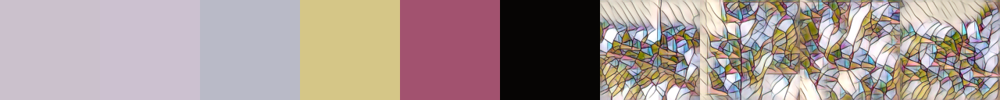


>>> saving checkpoint=full_coco2014_epoch_0.h5
 
epoch: 1 >>> loss: [2789735.8   123543.86  201614.2   542520.75  362413.84  931010.9
  173178.44]

 4287/20695 [=====>........................] - ETA: 4:12:32 - loss: 2789735.7944 - output_1_loss: 120542.3594 - output_2_loss: 371875.9688 - output_3_loss: 883379.8750 - output_4_loss: 334862.0312 - output_5_loss: 951806.8750 - output_6_loss: 127268.3047

InvalidArgumentError: ignored

In [30]:
np.random.seed(SEED)
tf.random.set_seed(SEED)

TransformerNetwork_VGG = tf_transformer.TransformerNetwork_VGG(style_image, batch_size=BATCH_SIZE)

# # Optimizer settings
optimizer = tf.optimizers.Adam(learning_rate=ADAM_LR, beta_1=0.99, epsilon=1e-1)


# helpers for monitoring training
stacker = helpers.ImgStacker()
stacker.clear()
validation_imgs = [ image for image in tensor_ds_255.take(10)]
# validation_imgs = [ image for image in tensor_ds_255.batch(10).take(1) ]
# callbacks
Snapshot = SnapshotCallback(validation_imgs, 
                            model=TransformerNetwork_VGG, 
                            stacker=stacker, 
                            save_image_path=SAVE_IMAGE_PATH,
                            log_after_batch=250 if IS_GPU else 10)

checkpoint_path = os.path.join(SAVE_MODEL_PATH, "full_coco2014")
Checkpoints = CheckpointCallback(TransformerNetwork_VGG, checkpoint_path)
History = HistoryCallback()

NUM_EPOCHS = 2
NUM_BATCHES = coco2014_tensor_ds.count/BATCH_SIZE

ONES =                          [1.,1.,1.,1.,1.,1.,]
normalized_weights =            [  19.83, 2209.59,   24.08,    7.41,    1.3,  2303.04]
FEATURE_WEIGHTS = normalized_weights

TransformerNetwork_VGG.compile(
  optimizer=optimizer,
  loss=get_MEAN_mse_loss,
)

callbacks = [
  Snapshot,
  Checkpoints,
  History,
  tf.keras.callbacks.TensorBoard(log_dir=LOG_PATH),
]

Snapshot.push_latest()

tensor_ds_255 = coco2014_tensor_ds
BATCH_xy_Dataset255_with_features = BATCH_xyGenerator_y_true_as_features_and_weights(
      tensor_ds_255, 
      TransformerNetwork_VGG.vgg,
      feature_weights=FEATURE_WEIGHTS
    )
train_dataset = BATCH_xy_Dataset255_with_features.take(BATCH_SIZE * NUM_BATCHES)

history = TransformerNetwork_VGG.fit(
  x=train_dataset.repeat(NUM_EPOCHS),
  epochs=NUM_EPOCHS,
  steps_per_epoch=NUM_BATCHES,
  callbacks=callbacks,
)

Snapshot.show_latest()


History.history() returns epoch losses


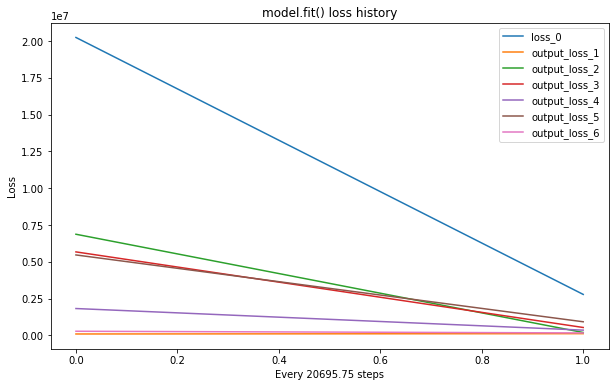


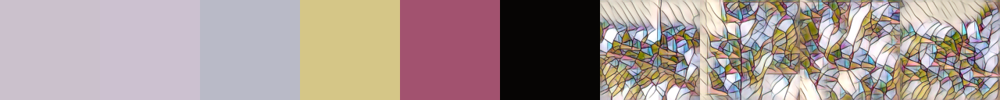

History.history() returns epoch losses
[[20247858.     101869.03  6878129.    5678755.5   1830513.    5471404.5
    287185.03]
 [ 2789735.8    123543.86   201614.2    542520.75   362413.84   931010.9
    173178.44]]


In [31]:
# plot losses
# history_losses = history.history # from model.fit()
history_losses = History.history(as_dict=True) # shape=(NUM_EPOCHS, 6)

plt.figure(figsize=[10, 6])
for i,(k,v) in enumerate(history_losses.items()):
  x = [i for i in range(len(v))]
  plt.plot(x, v, label=k)

plt.legend()
plt.xlabel('Every {} steps'.format(NUM_BATCHES))
plt.ylabel('Loss')
plt.title("model.fit() loss history")
plt.show()

show(Snapshot.stacker.hstack(), domain=(0,255))

losses = History.history()
print(np.stack(losses, axis=0))

In [32]:
history0 = history
history1 = History.history(as_dict=True)
def get_normalized_weights_from_loss_history(history, step=-1):
  """ get normalized loss weights from a training run with no loss weights
    history = model.fit() with no loss weights
  """
  if hasattr(history, 'history'): history = history.history
  assert isinstance(history, dict), "ERROR: expecting history.history as dict of losses"

  losses = np.asarray([v for k,v in history.items()])
  step_losses = losses[-6:,-1]          # ignore total loss if present
  total_loss = np.sum(step_losses)
  loss_weights = total_loss/step_losses
  np.set_printoptions(precision=2, suppress=True) # don't use scientific notation
  print("step={}, losses={}".format(losses.shape[1],  step_losses))
  print("normalized weights:", loss_weights)
  return loss_weights

print("\nhistory: model.fit()")
_ = get_normalized_weights_from_loss_history(history0)
print("\nhistory: History.history()")
_ = get_normalized_weights_from_loss_history(history1)

History.history() returns epoch losses

history: model.fit()
step=2, losses=[ 516119.88  191086.56 1250993.88 1606972.75 3592081.    801300.31]
normalized weights: [15.42 41.65  6.36  4.95  2.22  9.93]

history: History.history()
step=2, losses=[123543.86 201614.2  542520.75 362413.84 931010.9  173178.44]
normalized weights: [18.89 11.58  4.3   6.44  2.51 13.48]


array([18.89, 11.58,  4.3 ,  6.44,  2.51, 13.48], dtype=float32)

In [33]:
FEATURE_WEIGHTS = fnstf_utils.get_normalized_weights_from_loss_history(history)


step=2, losses=[7958553.6   516119.88  191086.56 1250993.88 1606972.75 3592081.
  801300.31]
normalized weights: [ 2.   30.84 83.3  12.72  9.91  4.43 19.86]


## predict

style transfer, checkpoint=0:



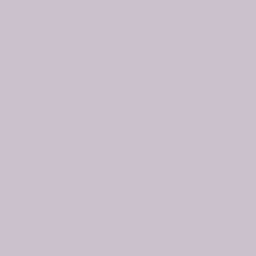
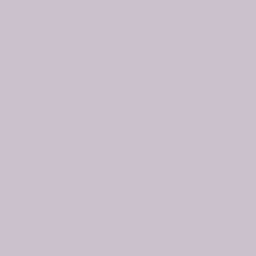
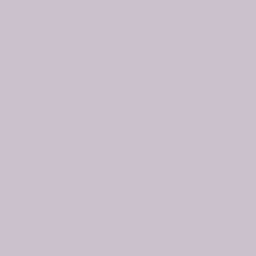
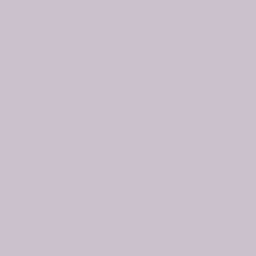

style transfer, checkpoint=2000:



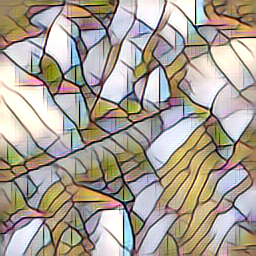
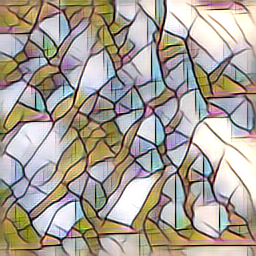
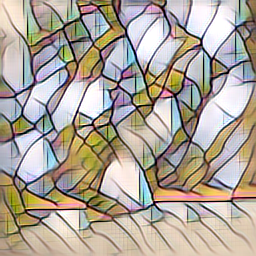
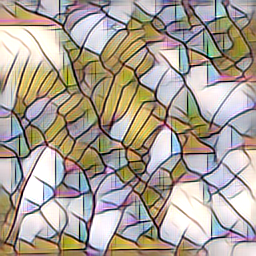

style transfer, checkpoint=3700:



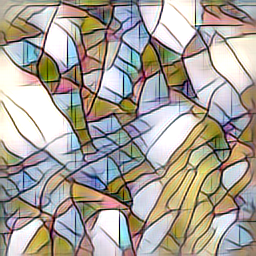
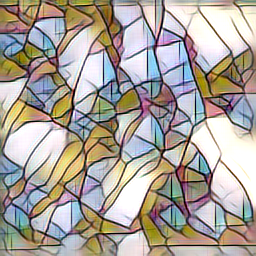
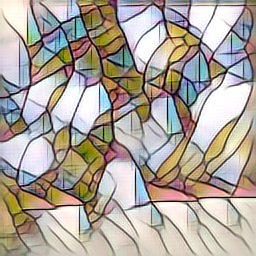
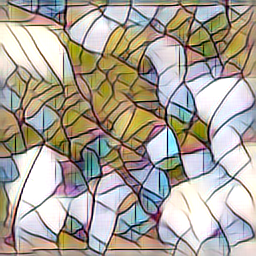

style transfer, checkpoint=3800:



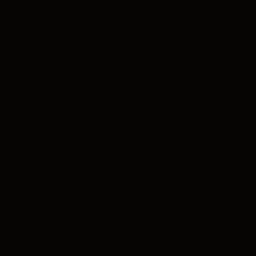
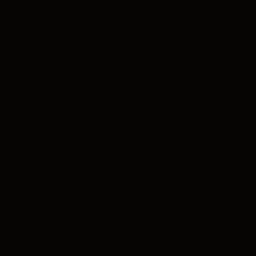
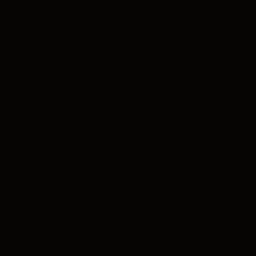
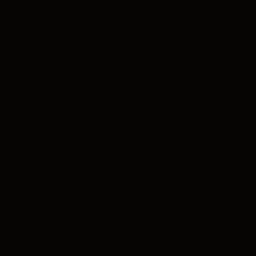


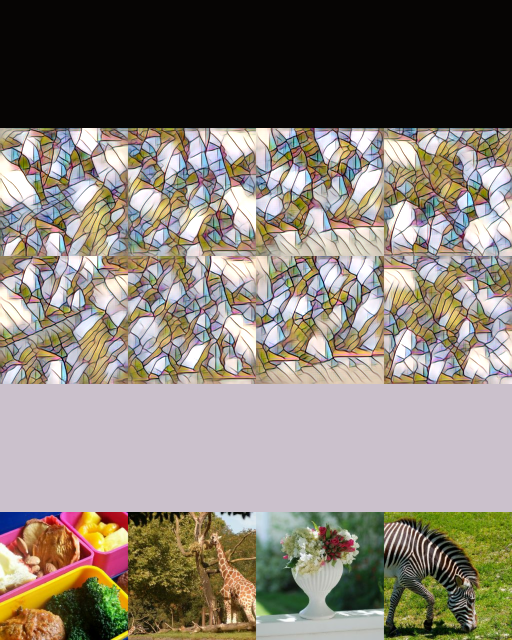

In [18]:
outputs=[]
for path in [LOG_PATH, SAVE_MODEL_PATH]:
  f = os.path.dirname(path)
  if not os.path.isdir(f): os.mkdir(path)


predict_imgs = image_ds_255.map(lambda d: d['image']).batch(4).take(1)
for batch in predict_imgs:
  outputs.append(batch)

  CHECKPOINTS = [0, 2000, 3700, 3800] # use ascending order
  for CHECKPOINT in CHECKPOINTS:
    load_file = os.path.join(SAVE_MODEL_PATH, "full_coco2014_step_{}.h5".format(CHECKPOINT))

    # TransformerNetwork_VGG = tf_transformer.TransformerNetwork_VGG(style_image, batch_size=BATCH_SIZE)
    # TransformerNetwork = TransformerNetwork_VGG.transformer
    TransformerNetwork = tf_transformer.TransformerNetwork()
    TransformerNetwork.build(input_shape=(None,256,256,3))
    TransformerNetwork.load_weights(load_file)
    predictions = TransformerNetwork.predict(batch)
    predictions = tf.floor(predictions)
    if True:
      print("style transfer, checkpoint={}:".format(CHECKPOINT))
      show(predictions, domain=(0,255), w=128)
    outputs.append(predictions)

print("\n")


batch_stacker = helpers.ImgStacker()
batch_stacker.clear()
batch_stacker.vstack(outputs, smaller=True)
show(batch_stacker.vstack(), domain=(0,255))


# `tf.GradientTape` 


### tf.GradientTape with `TransformerNetwork_VGG()`

In [0]:
# use_checkpoints_and_tboard()

In [0]:
### tf.GradientTape:

np.random.seed(SEED)
tf.random.set_seed(SEED)

### configure for TransformerNetwork_VGG 
# TransformerNetwork_VGG = tf_transformer.TransformerNetwork_VGG(style_image, batch_size=BATCH_SIZE)
TransformerNetwork_VGG = TransformerNetwork_VGG2(style_image)

TransformerNetwork = TransformerNetwork_VGG.transformer
VGG = TransformerNetwork_VGG.vgg

ONES =                          [1.,1.,1.,1.,1.,1.,]
normalized_weights =            [   18.54,           1605.23,   25.08,    8.16,    1.28, 2330.79]
boost_style_FEATURE_WEIGHTS =   [   0.1854,          1605.23,   25.08,    8.16,    1.28, 2330.79]  # boost style loss x100
FEATURE_WEIGHTS = normalized_weights

BATCH_xy_Dataset255_with_features = BATCH_xyGenerator_y_true_as_features_and_weights(
      tensor_ds_255, 
      TransformerNetwork_VGG.vgg,
      feature_weights=FEATURE_WEIGHTS
    )
train_dataset = BATCH_xy_Dataset255_with_features.take(BATCH_SIZE * NUM_BATCHES)
NUM_EPOCHS = 5
NUM_BATCHES = 250 # =1000/BATCH_SIZE



# NUM_EPOCHS = 2
# NUM_BATCHES = coco2014_tensor_ds.count/BATCH_SIZE
# SAVE_MODEL_EVERY = 100 # 2,000 Images with batch size 4

# pre-flight
stacker = helpers.ImgStacker()
stacker.clear()
validation_imgs = [ image for image in tensor_ds_255.take(10)]
show(validation_imgs, domain=None, w=128)

# callbacks
Snapshot = SnapshotCallback(validation_imgs, 
                            model=TransformerNetwork_VGG, 
                            stacker=stacker, 
                            log_after_batch=500)
checkpoint_path = os.path.join(SAVE_MODEL_PATH, "full_coco2014")
Checkpoints = CheckpointCallback(TransformerNetwork_VGG, checkpoint_path)
History = HistoryCallback()

def train():
  # # Seeds
  np.random.seed(SEED)
  tf.random.set_seed(SEED)

  # # Optimizer settings
  optimizer = tf.optimizers.Adam(learning_rate=ADAM_LR, beta_1=0.99, epsilon=1e-1)

  # # Loss trackers
  content_loss_history = []
  style_loss_history = []
  total_loss_history = []
  batch_content_loss_sum = 0.
  batch_style_loss_sum = 0.
  batch_total_loss_sum = 0.

  # # Optimization/Training Loop
  @tf.function()
  def train_step(x_train, y_true, loss_weights=None, log_freq=10):
    with tf.GradientTape() as tape:
      y_pred = TransformerNetwork_VGG(x_train)
      generated_content_features = y_pred[:1]
      generated_style_gram = y_pred[1:]
      

      y_true = TransformerNetwork_VGG.vgg(x_train)
      target_content_features = y_true[:1]
      target_style_gram = TransformerNetwork_VGG.vgg.target_style_gram

      if loss_weights:
        assert len(loss_weights) == len(y_pred), "ERROR: invalid format for loss_weights, got {}".format(loss_weights)

      # loss_function = get_SUM_mse_loss   
      loss_function = get_MEAN_mse_loss   
      weights = loss_weights[:1] if loss_weights else None
      content_loss = loss_function(target_content_features, generated_content_features, weights)

      weights = loss_weights[1:] if loss_weights else None
      # style_loss = loss_function(target_style_gram, generated_style_gram, weights)
      style_loss = tuple(loss_function(x,y)*w for x,y,w in zip(target_style_gram, generated_style_gram, weights))
      total_style_loss = tf.reduce_sum(style_loss)

      # apply batch_losses to grads
      total_loss = content_loss + total_style_loss
      TransformerNetwork = TransformerNetwork_VGG.transformer
      grads = tape.gradient(total_loss, TransformerNetwork.trainable_weights)
      optimizer.apply_gradients(zip(grads, TransformerNetwork.trainable_weights))
      return (content_loss, total_style_loss, style_loss)
      # end: with tf.GradientTape()
      # end: train_step()


  batch_count = 1
  Snapshot.push_latest()
  start_time = time.time()
  for epoch in range(NUM_EPOCHS):
    print("========Epoch {}/{}========".format(epoch+1, NUM_EPOCHS))
    for x_train, y_true, weights in train_dataset:
      # x_train, y_true are VGG features
      # print("{}: batch shape={}".format(batch_count, x_train.shape))
      # Get current batch size in case of odd batch sizes
      curr_batch_size = x_train.shape[0]

      #   # Backprop and Weight Update
      (content_loss, style_loss, s_loss) = train_step(x_train, y_true, loss_weights=FEATURE_WEIGHTS ) # 255.
      batch_content_loss_sum += content_loss
      batch_style_loss_sum += style_loss
      batch_total_loss_sum += (content_loss + style_loss)

      batch_no = History.on_batch_end( batch_count-1, losses=( (content_loss,) + s_loss) ) # loss= list of tuples    
      Snapshot.on_batch_end(batch_no)
      Checkpoints.on_batch_end(batch_no)

      # Save Model and Print Losses
      if (((batch_count-1)% SAVE_MODEL_EVERY == 0) or (batch_count==NUM_EPOCHS*NUM_BATCHES)):
        generated_batch = TransformerNetwork_VGG.transformer(x_train)
        # rgb_image = generated_batch[0]
        # check = stacker.hstack( tf.clip_by_value(rgb_image, 0.,255.), limit=NUM_EPOCHS, smaller=True )
        # show( check, domain=None )
        # check side by side
        # [rgb_image0, rgb_image] = [tf.squeeze(tf.clip_by_value(v[0], 0., 255.)) for v in [x_train, generated_batch]]
        # show([rgb_image0, rgb_image], domain=(0.,255.), w=128)

        # Print Losses
        print("========Iteration {}/{}========".format(batch_count, NUM_EPOCHS*NUM_BATCHES))
        print("\tContent Loss:\t{:.2f}".format(batch_content_loss_sum/batch_count))
        print("\tStyle Loss:\t{:.2f}".format(batch_style_loss_sum/batch_count))
        print("\tTotal Loss:\t{:.2f}".format(batch_total_loss_sum/batch_count))
        print("Time elapsed:\t{} seconds".format(time.time()-start_time))

        # rgb_image = tf.squeeze(generated_batch[0,...]).numpy() # 255.
        # check = np.stack([np.amin(rgb_image, axis=(0,1)), np.average(rgb_image, axis=(0,1)), np.amax(rgb_image, axis=(0,1))], axis=1)
        # print( "\tImage, (min,mean,max):\t{}".format( check ) )

        # rgb_batch = tf.image.convert_image_dtype(generated_batch/255., dtype=tf.uint8, saturate=True)
        generated_batch = tf.clip_by_value(generated_batch, 0.,255.)
        show(generated_batch, w=128, domain=(0,255))

        # Save loss histories
        content_loss_history.append((batch_content_loss_sum/batch_count).numpy())
        style_loss_history.append((batch_style_loss_sum/batch_count).numpy())
        total_loss_history.append((batch_total_loss_sum/batch_count).numpy())


      # Iterate Batch Counter
      batch_count+=1

    # end epoch, summarize batch_losses
    print(">>>> epoch={} complete".format(epoch+1))
    epoch_loss = History.on_epoch_end( epoch+1 ) # close batch, return sum of batch_losses, shape=(1,6)
    print(">>>> \tepoch={}: losses= {}".format(epoch+1, epoch_loss.numpy()))
    Snapshot.on_epoch_end(epoch)
    Checkpoints.on_batch_end(batch_no)

    # # Save Model
    # if batch_count>1:
    #   checkpoint_path = os.path.join(SAVE_MODEL_PATH, "grad-tape_checkpoint_{}.h5".format(epoch+1))
    #   TransformerNetwork_VGG.transformer.save_weights(checkpoint_path, save_format='h5')
    #   print("Saved tf TransformerNetwork checkpoint file at {}".format(checkpoint_path))

    # # Save generated image
    # sample_image_path = os.path.join(SAVE_IMAGE_PATH, "tf_sample_{}.png".format(epoch+1))
    # im=Image.fromarray(np.uint8(stacker.hstack()))
    # im.save(sample_image_path)
    # print("Saved sample tranformed image at {}".format(sample_image_path))

  stop_time = time.time()

  # Print loss histories
  print("Done Training the Transformer Network!")
  print("Training Time: {} seconds".format(stop_time-start_time))
  print("========Content Loss========")
  print(content_loss_history) 
  print("========Style Loss========")
  print(style_loss_history) 
  print("========Total Loss========")
  print(total_loss_history) 
  # Plot Loss Histories
  if (PLOT_LOSS):
      torch_utils.plot_loss_hist(content_loss_history, style_loss_history, total_loss_history)

  # save generated image history
  sample_image_path = os.path.join(SAVE_IMAGE_PATH , "tf_sample_{}.png".format(NUM_EPOCHS*NUM_BATCHES))
  im=Image.fromarray(np.uint8(stacker.hstack()))
  im.save(sample_image_path)

train()


In [0]:
history = History.history(as_dict=True) # shape=(NUM_EPOCHS, 6)
fnstf_utils.get_normalized_weights_from_loss_history(history)

# plot losses
plt.figure(figsize=[10, 6])
for i,(k,v) in enumerate(history_losses.items()):
  x = [i for i in range(len(v))]
  plt.plot(x, v, label=k)

plt.legend()
plt.xlabel('Every {} steps'.format(BATCH_SIZE * NUM_BATCHES))
plt.ylabel('Loss')
plt.title("GradientTape loss history")
plt.show()

Snapshot.show_latest()

In [0]:
assert False

style_model = tf_vgg.get_layers()

def vgg_layers19(content_layers, style_layers, input_shape=(256,256,3)):
  """ creates a VGG model that returns output values for the given layers
  see: https://keras.io/applications/#extract-features-from-an-arbitrary-intermediate-layer-with-vgg19

  Returns: 
    function(x, preprocess=True):
      Args: 
        x: image tuple/ndarray h,w,c(RGB), domain=(0.,255.)
      Returns:
        a tuple of lists, ([content_features], [style_features])

  usage:
    (content_features, style_features) = vgg_layers16(content_layers, style_layers)(x_train)
  """
  from tensorflow.keras.applications.vgg19 import preprocess_input
  base_model = tf.keras.applications.VGG19(include_top=False, weights='imagenet', input_shape=input_shape)
  return VGG_Model(content_layers, style_layers, base_model, preprocessingFn=preprocess_input)

class VGG_Model(tf.keras.models.Model):
  def __init__(self, content_layers, style_layers, base_model, preprocessingFn=None, **kwargs):
    super(VGG_Model, self).__init__(**kwargs)
    self.layer_names = content_layers + style_layers
    self.content_layer_split = len(content_layers)
    self.preprocessingFn = preprocessingFn
    base_model.trainable = False
    content_features = [base_model.get_layer(name).output for name in content_layers]
    style_features = [base_model.get_layer(name).output for name in style_layers]
    output_features = content_features + style_features
    self.model = tf.keras.models.Model( inputs=base_model.input, outputs=output_features, name="vgg_layers")
    self.model.trainable = False

  def call(self, x, preprocess=True):
    if preprocess and callable(self.preprocessingFn): 
      x = self.preprocessingFn(x)
    output = self.model(x) # call as tf.keras.Layer()
    return ( output[:self.content_layer_split], output[self.content_layer_split:] )

vgg = vgg_layers19(style_model['content_layers'], style_model['style_layers'] )
vgg.build(input_shape=(None,256,256,3))
vgg.summary()